In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import altair as alt

alt.data_transformers.disable_max_rows()
alt.renderers.enable("mimetype")

RendererRegistry.enable('mimetype')

# Predicting customer response to Bank telemarketing campaign

## Introduction

Telemarketing campaigns can be very expensive to institutions. The possibility to predict the likelihood of customer response can lead to more efficient strategies, that reduce implementation costs and maximize the success rate.

The objective of this project is to identify which customers are more likely to respond positively to the telemarketing campaign and subscribe to a new product (a long-term deposit). 
To address the predictive question posed above, we plan to conduct an exploratory data analysis identify the best features that can help identify the audience and how they are interrelated. We will examine the variable distributions using summary tables and data visualization tools. Ultimately, we want to build a machine learning model that can predict if a certain customer looks alike the target audience for this product.


### Data

The data set used in this project is related with direct marketing campaigns (phone calls) of a Portuguese banking institution, created by [Moro et al., 2014] S. Moro, P. Cortez and P. Rita. A Data-Driven Approach to Predict the Success of Bank Telemarketing. Decision Support Systems, Elsevier, 62:22-31, June 2014.

It can be found [here](http://archive.ics.uci.edu/ml/datasets/Bank+Marketing).

The data set contains 20 features, plus the desired target. Each row represents information of one client, including personal and banking attributes and information related to the past interactions with the telemarketer.

In [2]:
df = pd.read_csv('../data/processedbank-additional-train.csv')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32950 entries, 0 to 32949
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             32950 non-null  int64  
 1   job             32950 non-null  object 
 2   marital         32950 non-null  object 
 3   education       32950 non-null  object 
 4   default         32950 non-null  object 
 5   housing         32950 non-null  object 
 6   loan            32950 non-null  object 
 7   contact         32950 non-null  object 
 8   month           32950 non-null  object 
 9   day_of_week     32950 non-null  object 
 10  duration        32950 non-null  int64  
 11  campaign        32950 non-null  int64  
 12  pdays           32950 non-null  int64  
 13  previous        32950 non-null  int64  
 14  poutcome        32950 non-null  object 
 15  emp.var.rate    32950 non-null  float64
 16  cons.price.idx  32950 non-null  float64
 17  cons.conf.idx   32950 non-null 

In [4]:
df.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
count,32950.000000,32950.000000,32950.000000,32950.000000,32950.000000,32950.000000,32950.000000,32950.000000,32950.000000,32950.000000
mean,40.014932,258.566161,2.557360,962.414325,0.172838,0.090734,93.577104,-40.483005,3.632576,5167.523250
std,10.407901,259.417876,2.720866,187.062931,0.493937,1.569535,0.578993,4.622691,1.730625,71.969364
min,17.000000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000
25%,32.000000,103.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000
50%,38.000000,180.000000,2.000000,999.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000
75%,47.000000,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000
max,98.000000,4918.000000,56.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000


In [5]:
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,35,entrepreneur,married,high.school,no,no,no,telephone,may,fri,...,2,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,22,services,single,professional.course,no,no,no,cellular,jul,tue,...,3,999,1,failure,-1.7,94.215,-40.3,0.835,4991.6,yes
2,38,blue-collar,married,unknown,no,yes,no,telephone,jun,fri,...,5,999,0,nonexistent,1.4,94.465,-41.8,4.959,5228.1,no
3,25,blue-collar,single,basic.9y,unknown,yes,no,cellular,jul,wed,...,2,999,0,nonexistent,1.4,93.918,-42.7,4.963,5228.1,no
4,37,technician,married,university.degree,no,no,no,cellular,aug,wed,...,4,999,0,nonexistent,1.4,93.444,-36.1,4.964,5228.1,no


In [6]:
df.tail()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
32945,26,management,single,university.degree,no,no,no,telephone,jun,mon,...,3,999,0,nonexistent,1.4,94.465,-41.8,4.865,5228.1,no
32946,43,blue-collar,married,basic.9y,no,yes,no,cellular,jul,fri,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.957,5228.1,no
32947,54,management,married,university.degree,no,no,yes,cellular,jul,tue,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.961,5228.1,no
32948,39,services,married,high.school,no,no,no,cellular,apr,thu,...,2,999,2,failure,-1.8,93.075,-47.1,1.483,5099.1,no
32949,36,technician,married,basic.4y,no,no,no,cellular,jul,mon,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.960,5228.1,yes


#### Balance of the target variable - y

In [7]:
df['y'].value_counts()

no     29250
yes     3700
Name: y, dtype: int64

In [8]:
df['y'].value_counts(normalize=True)

no     0.887709
yes    0.112291
Name: y, dtype: float64

The response variable `y` has imbalance distribution where only about `11%` of the records are targeted as `y` - responded to previous telemarketing.

#### Examine Numerical features

In [9]:
df_numeric = df.select_dtypes('number')
df_numeric

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
0,35,178,2,999,0,1.1,93.994,-36.4,4.857,5191.0
1,22,256,3,999,1,-1.7,94.215,-40.3,0.835,4991.6
2,38,42,5,999,0,1.4,94.465,-41.8,4.959,5228.1
3,25,442,2,999,0,1.4,93.918,-42.7,4.963,5228.1
4,37,107,4,999,0,1.4,93.444,-36.1,4.964,5228.1
...,...,...,...,...,...,...,...,...,...,...
32945,26,72,3,999,0,1.4,94.465,-41.8,4.865,5228.1
32946,43,226,1,999,0,1.4,93.918,-42.7,4.957,5228.1
32947,54,218,1,999,0,1.4,93.918,-42.7,4.961,5228.1
32948,39,598,2,999,2,-1.8,93.075,-47.1,1.483,5099.1


#### Distribution of the numerical variables

''

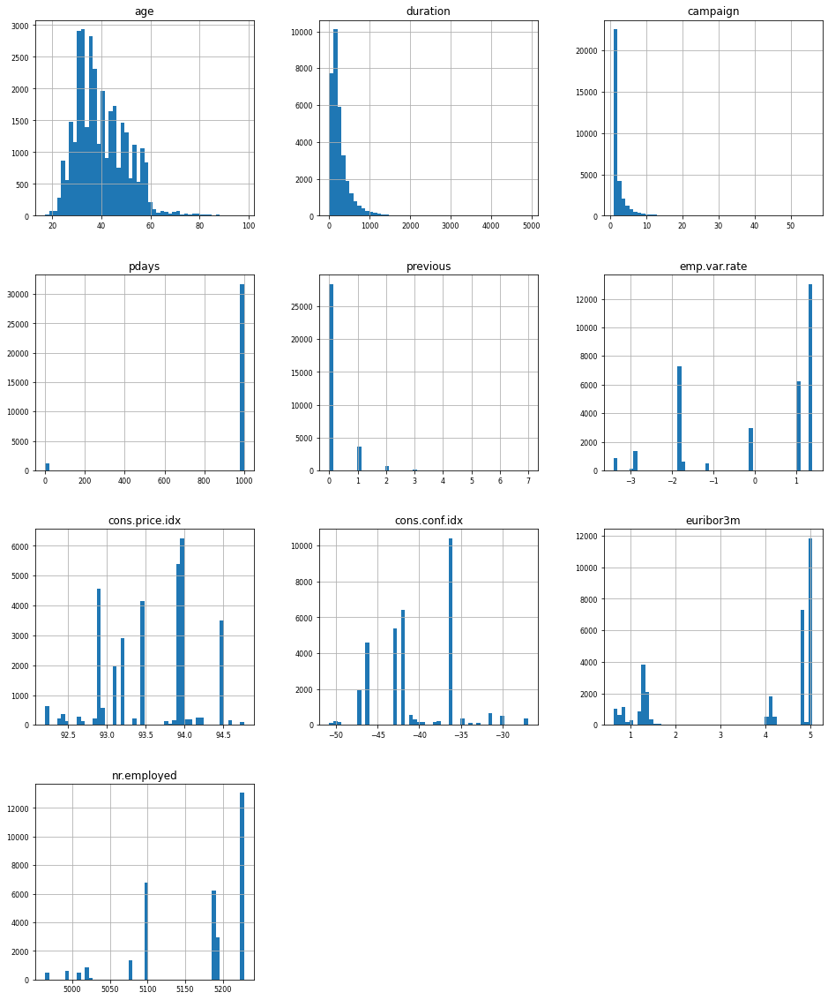

In [10]:
df_numeric.hist(figsize=(16, 20), bins=50, xlabelsize=8, ylabelsize=8)
plt.title('aa')
;

#### Scatter plot matrices of the numerical variables:

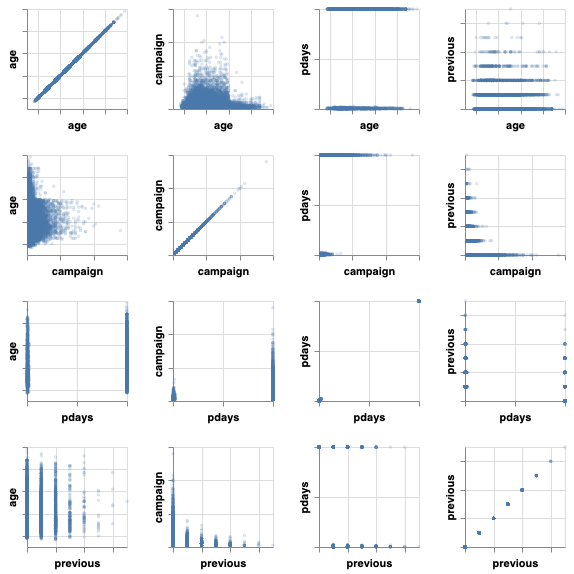

In [11]:
#numeric_cols = df.select_dtypes("number").columns.tolist()
numeric_cols = ['age', 'campaign', 'pdays', 'previous']

splom = (
    alt.Chart(df)
    .mark_point(size=2, opacity=0.2)
    .encode(
        alt.X(alt.repeat("row"), type="quantitative", scale=alt.Scale(zero=False)),
        alt.Y(alt.repeat("column"), type="quantitative", scale=alt.Scale(zero=False)),
    )
    .properties(width=100, height=100)
    .repeat(column=numeric_cols, row=numeric_cols)
    .configure_axis(labels=False)
)

# Show the plot
splom

#### Correlation of some key variables with the response variable

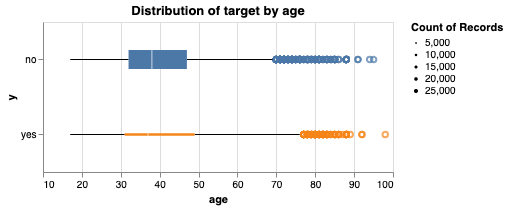

In [16]:
(alt.Chart(df, title = "Distribution of target by age")
.mark_boxplot().encode(
    x=alt.X('age', scale=alt.Scale(zero=False)),
    y='y',
    color=alt.Color('y', legend=None),
    size='count()')
).properties(width=350, height=150)

#### Distribution of last contacted month against those responded to the previous telemarketing.

In [13]:
df_positives = df[df['y']=='yes']

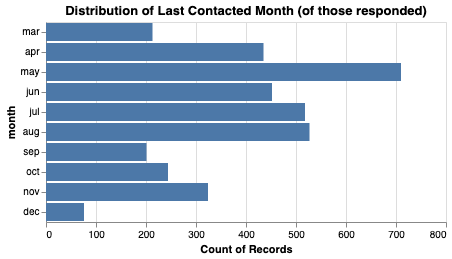

In [14]:
alt.Chart(df_positives, title = "Distribution of Last Contacted Month (of those responded)").mark_bar().encode(
    y=alt.Y('month', sort=['mar','apr','may','jun','jul','aug','sep','oct','nov','dec']),
    x='count()')

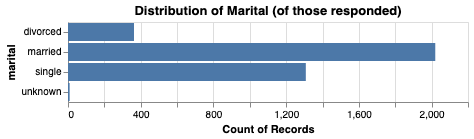

In [15]:
alt.Chart(df_positives, title = "Distribution of Marital (of those responded)").mark_bar().encode(
    y=alt.Y('marital'),
    x='count()')

We have small number of records who have `unknown` marital status, it could be interesting to see if the same people who does not provide marital status may also more likely to not respond to the telemarketing since they may not like to be bother by advertisements.

### Methods 

* The Bank data is partitioned into training and testing set (by default split at - 80%:20%). 
* The project team will examine several types of models (e.g. logistic regression, decision trees, etc.) with additional tuning via hyper-parameter optimization.
* The project team will agree on a combination of metrics suitable for this particular project (yet to be defined). Models will be evaluated based on cross-validation performance.
* Final report will include the final model with results and conclusions, including summary statistics and visualizations.